In [1]:
import pandas as pd

COLS = ["id", "lat", "long", "text"]
df_train = pd.read_csv("../data/training.txt", names=COLS)
df_val = pd.read_csv("../data/validation.txt", names=COLS)

df_train.head()

,id,lat,long,text
0,119165,51.810067,10.191331,"Seit d Vase: ""Wenn ich kaputt gang, bringt das..."
1,100377,51.918188,10.599245,Haha bin au w isch der amig au so richtig lang...
2,109550,52.711074,9.987374,isch d hiltl dachterrasse amne samstig viel bs...
3,111440,52.386711,11.700612,Ich fühle mich wie die Weimarer Republik... .....
4,116670,52.314631,9.701835,Eui liebschte Lunchidee zum Mitneh? 😬 En Grill...


In [2]:
bounding_box = (df_train.long.min(), df_train.long.max(), df_train.lat.min(), df_train.lat.max())
print(f"train: {bounding_box}")
print(f"validation: {(df_val.long.min(), df_val.long.max(), df_val.lat.min(), df_val.lat.max())}")

train: (7.030000000000001, 12.7, 48.16999999999999, 53.53999999999999)
validation: (7.1115827338129485, 12.7, 48.16999999999999, 53.53999999999999)


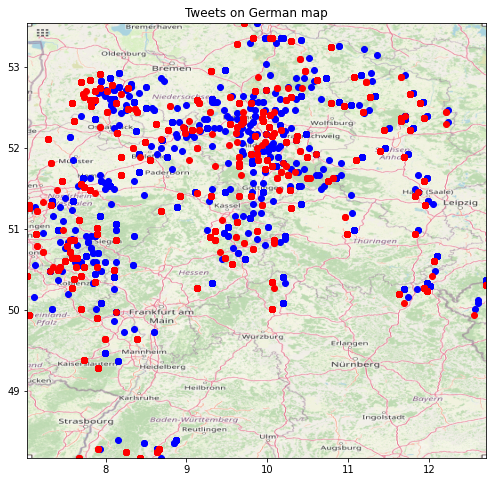

In [3]:
import matplotlib.pyplot as plt

gmap = plt.imread("../data/map.png")
fix, ax = plt.subplots(figsize=(15, 8))
ax.scatter(df_train.long, df_train.lat, zorder=1, c='r')
ax.scatter(df_val.long, df_val.lat, zorder=0.5, c='b')

ax.set_title('Tweets on German map')
ax.set_xlim(bounding_box[0], bounding_box[1])
ax.set_ylim(bounding_box[2], bounding_box[3])
ax.imshow(gmap, zorder=0, extent=bounding_box)

In [4]:
from sklearn.cluster import KMeans
import numpy as np

def kmeans(points, num_clusters):
    km = KMeans(n_clusters=num_clusters, random_state=0).fit(points)
    return km

def get_clusters(kmeans, points, num_clusters):
    clusters = [[] for _ in range(num_clusters)]
    for point, label in zip(points, kmeans.labels_):
        clusters[label].append(point)
    return clusters

In [5]:
def predict_error(kmeans, coords):
    predicted = np.array(
        [kmeans.cluster_centers_[label] for label in kmeans.predict(coords)]
    )
    mae = np.abs(coords - predicted).mean(axis=0)
    assert mae.shape == (2,)
    return mae[0] + mae[1]

In [6]:
import math
from tqdm import tqdm


def dist(point1, point2):
    earth_radius = 6373
    lat1, long1 = point1
    lat2, long2 = point2
    lat1 = math.radians(lat1)
    lat2 = math.radians(lat2)
    long1 = math.radians(long1)
    long2 = math.radians(long2)
    
    delta_lat = lat2 - lat1
    delta_long = long2 - long1
    
    a = math.sin(delta_lat/2)**2 + math.cos(lat1) * math.cos(lat2) * math.sin(delta_long/2)**2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))

    return earth_radius * c


def max_dist(clusters):
    dmax = 0
    for cluster in tqdm(clusters):
        for first in cluster:
            for second in cluster:
                dmax = max(dmax, dist(first, second))
    return dmax


def cluster_stats(NUM_CLUSTERS):
    print(f"Trying for {NUM_CLUSTERS} clusters")
    coords = np.array([
        [longitude, latitude]
        for longitude, latitude in zip(df_train.long, df_train.lat)
    ])

    km = kmeans(coords, NUM_CLUSTERS)
    clusters = get_clusters(km, coords, NUM_CLUSTERS)

    print(f"MAXDIST: {max_dist(clusters)}")

    map = plt.imread("../data/map.png")
    fix, ax = plt.subplots(figsize=(15, 8))
    ax.imshow(gmap, zorder=0, extent=bounding_box)
    ax.set_title(f'{NUM_CLUSTERS}-Clustered tweets on German map')
    ax.set_xlim(bounding_box[0], bounding_box[1])
    ax.set_ylim(bounding_box[2], bounding_box[3])

    cmap = plt.cm.get_cmap("hsv", NUM_CLUSTERS)
    for i, cluster in enumerate(clusters):
        ax.scatter(
            [first for first, _ in cluster],
            [second for _, second in cluster],
            zorder=1,
            color=cmap(i)
        )

    print(f"Cluster sizes: {[len(cluster) for cluster in clusters]}")
    print(f"Min cluster: {min([len(cluster) for cluster in clusters])}")
    mae = predict_error(km, np.array([
        [longitude, latitude]
        for longitude, latitude in zip(df_val.long, df_val.lat)
    ]))

    print(f"Prediction error for validation: {mae}")

Trying for 10 clusters
100%|██████████| 10/10 [02:22<00:00, 14.22s/it]
MAXDIST: 261.39340712069225
Cluster sizes: [2084, 3464, 2480, 1256, 2628, 1539, 1136, 1748, 3741, 2507]
Min cluster: 1136
Prediction error for validation: 0.4860552985090647
Trying for 15 clusters
100%|██████████| 15/15 [01:41<00:00,  6.76s/it]
MAXDIST: 162.72582859828805
Cluster sizes: [2771, 1364, 1220, 2571, 1617, 2167, 1329, 1648, 950, 137, 1197, 2648, 724, 913, 1327]
Min cluster: 137
Prediction error for validation: 0.40020817973481654
Trying for 20 clusters
100%|██████████| 20/20 [01:13<00:00,  3.67s/it]
MAXDIST: 162.34509456559925
Cluster sizes: [1350, 1364, 1148, 2034, 1567, 1793, 950, 1099, 950, 137, 1191, 967, 315, 635, 1327, 522, 1025, 598, 1732, 1879]
Min cluster: 137
Prediction error for validation: 0.32305901903671175
Trying for 25 clusters
100%|██████████| 25/25 [01:08<00:00,  2.74s/it]
MAXDIST: 181.4326512926188
Cluster sizes: [1062, 1336, 518, 1055, 2577, 913, 1043, 1322, 1792, 1397, 137, 1068, 967,

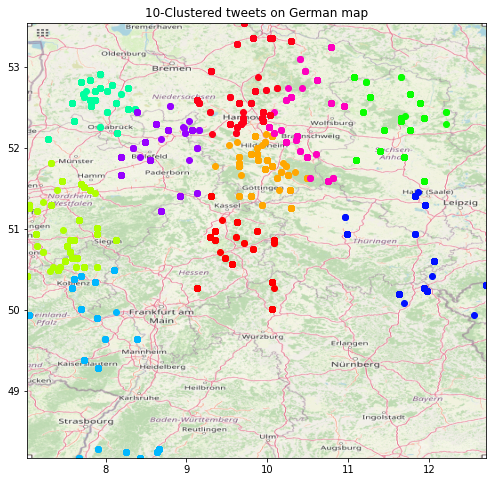

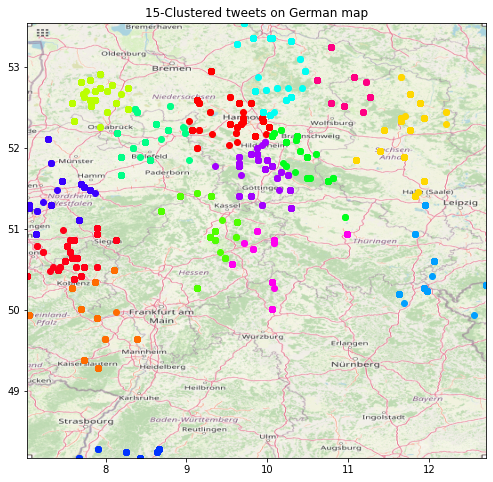

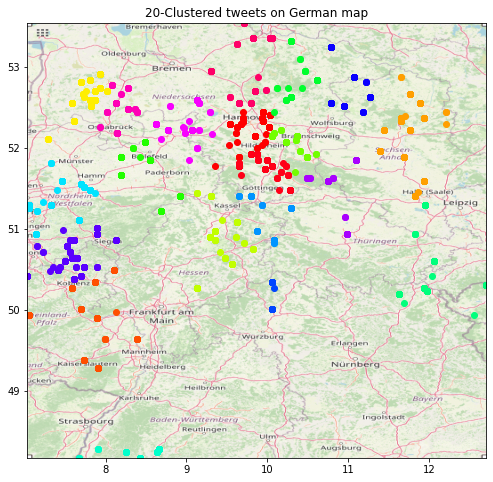

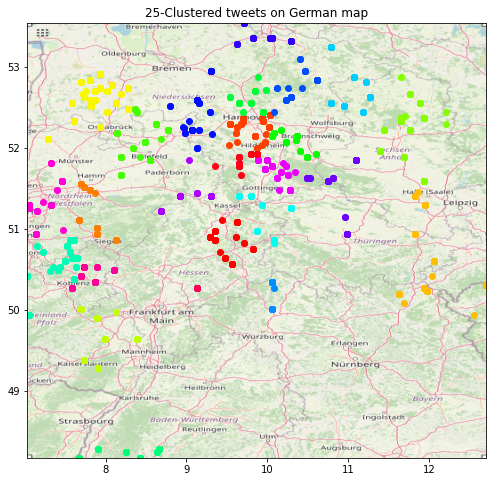

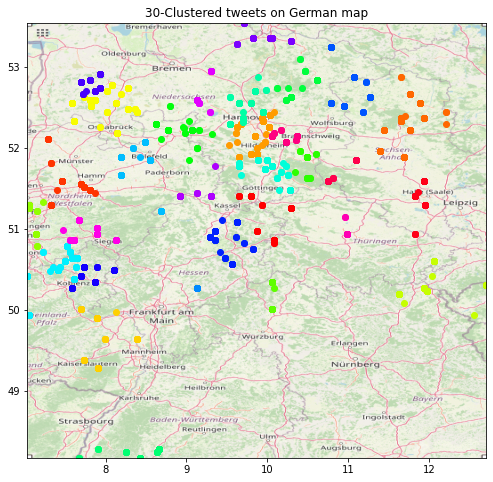

In [17]:
for i in [10, 15, 20, 25, 30]:
    cluster_stats(i)

In [10]:
cities_df = pd.read_csv("../data/de.csv")
cities_df.dropna(subset=["population"], inplace=True)
cities_df.tail()

,city,lat,lng,country,iso2,admin_name,capital,population,population_proper
597,Altenkirchen,50.6872,7.6456,Germany,DE,Rhineland-Palatinate,minor,6263.0,6263.0
598,Neustadt,49.7306,12.1706,Germany,DE,Bavaria,minor,5727.0,5727.0
599,Seelow,52.5167,14.3831,Germany,DE,Brandenburg,minor,5426.0,5426.0
600,Kusel,49.5347,7.3981,Germany,DE,Rhineland-Palatinate,minor,5405.0,5405.0
601,Cochem,50.1469,7.1667,Germany,DE,Rhineland-Palatinate,minor,5312.0,5312.0


In [38]:
from sklearn.neighbors import KDTree
from collections import defaultdict

def city_classes(df, df_test, cities_df, thresh=0):
    cities_df = cities_df[cities_df.population >= thresh]
    cities = np.array(cities_df.city)
    city_coords = np.array([[lat, lng] for lat, lng in zip(cities_df.lat, cities_df.lng)])

    kdtree = KDTree(city_coords)

    classes = defaultdict(list)
    for _, row in df.iterrows():
        _, ind = kdtree.query(np.array([[row.lat, row.long]]), k=1)
        classes[ind[0][0]].append([row.lat, row.long])
    
    city_coords = np.array([city_coords[i] for i in classes.keys()])
    kdtree = KDTree(city_coords)
    err = 0
    for _, row in df_test.iterrows():
        _, ind = kdtree.query(np.array([[row.lat, row.long]]), k=1)
        err += abs(city_coords[ind[0][0]][0] - row.lat) + abs(city_coords[ind[0][0]][1] - row.long)

    print(err/(2*len(df_test)))
    return classes


classes = city_classes(df_train, df_val, cities_df, thresh=200000)
print(len(classes))

0.29758997499840867
24
